# William Meynardie - STATS 507 Final Project

## Classifying Images of Animals Using the Vision Transformer

Note on usage of outside materials: much of the code for classifying my own individual images comes from the "Inference" and "Pipeline API" sections of this [example notebook](https://colab.research.google.com/github/huggingface/notebooks/blob/main/examples/image_classification.ipynb#scrollTo=I7mz7QTo_jWa). I discussed code to generate the final figure with Robert Frazier.

We start by importing some modules.

In [9]:
import matplotlib.pyplot as plt
import os
from datasets import load_dataset
from huggingface_hub import notebook_login

# notebook_login()

We load in the fine-tuned model from Hugging Face.

In [2]:
from transformers import AutoModelForImageClassification, AutoImageProcessor

repo_name = "wmeynard/vit-animals"

image_processor = AutoImageProcessor.from_pretrained(repo_name)
model = AutoModelForImageClassification.from_pretrained(repo_name)

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


We start by trying to classify one image. Let's load in a picture of Daisy (my dog).

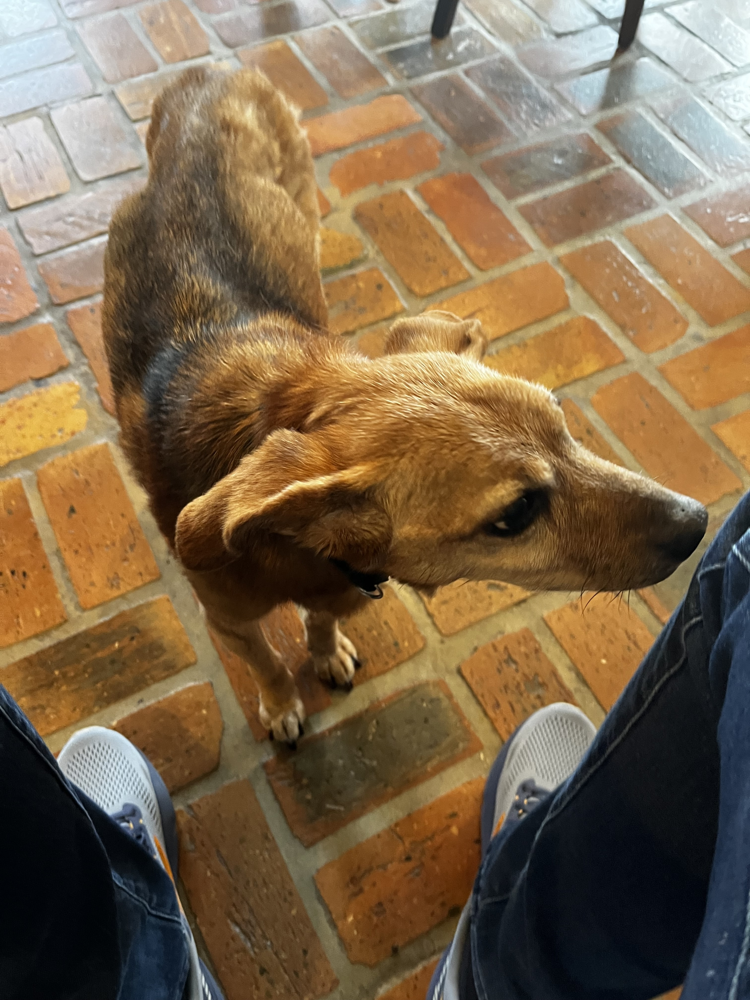

In [3]:
from PIL import Image

filepath = './sample/Daisy.jpg'
image = Image.open(filepath)
image

She doesn't like to sit still for pictures. But she's a cutie.

In [4]:
# prepare image for the model
encoding = image_processor(image.convert("RGB"), return_tensors="pt")
print(encoding.pixel_values.shape)

torch.Size([1, 3, 224, 224])


In [5]:
import torch

# forward pass
with torch.no_grad():
    outputs = model(**encoding)
    logits = outputs.logits

We process the image and check the top few classifications. The winning classification is wolf. We find there's a 25% chance Daisy is a wolf (incorrect), and an 8% chance she's a dog. She'd be happy to hear the model thinks she's a wolf, so I'll have to tell her next time I go home. Wolves and dogs are similar, so these results aren't too bad.

In [6]:
predicted_class_idx = logits.argmax(-1).item()
print("Predicted class:", model.config.id2label[predicted_class_idx])

from transformers import pipeline

pipe = pipeline("image-classification", "wmeynard/vit-animals")
pipe(image)

Predicted class: wolf


Device set to use mps:0


[{'label': 'wolf', 'score': 0.24609613418579102},
 {'label': 'dog', 'score': 0.07631489634513855},
 {'label': 'coyote', 'score': 0.044195130467414856},
 {'label': 'lion', 'score': 0.03322920575737953},
 {'label': 'bear', 'score': 0.027641626074910164}]

Next, we define a function to process a list of images.

In [15]:
def process_all(images):
    encoded = []
    for image in images:
        encoded.append(image_processor(image.convert("RGB"), return_tensors="pt"))
    return encoded

We process all of the images, and make a figure that outputs their name, picture, and predicted classification. It does a really good job with the geese, a decent job with Daisy, and it has no idea what to do about the humans.

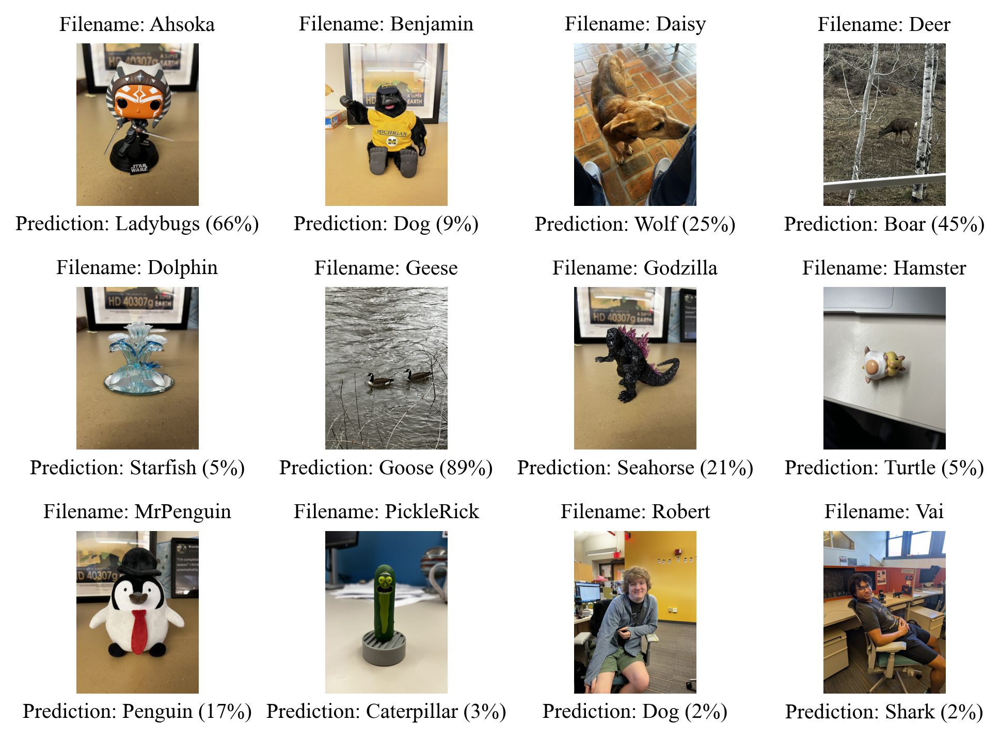

In [29]:
images = []
labels = []
fontname = 'Times New Roman'
filepath = "./sample"
files = sorted(os.listdir(filepath))

# Grab images and process them
for filename in files:
    if filename.endswith(".jpg"):
        image = Image.open(os.path.join(filepath, filename))
        images.append(image)
        labels.append(filename[:-4])
processed = process_all(images)

# Get predictions
predictions = []
with torch.no_grad():
    for i in range(len(processed)):
        outputs = model(**processed[i])
        logits = outputs.logits
        predicted_class_idx = logits.argmax(-1).item()
        predictions.append(predicted_class_idx)

# Plotting
rows, cols = 3, 4
fig, axes = plt.subplots(rows, cols, figsize=(6.5, 6.5*rows/cols), dpi=300)
for i, ax in enumerate(axes.flatten()):
    ax.axis('off')
    if i < len(images):
        ax.imshow(images[i])
        title = labels[i]
        chance = round(100*pipe(images[i])[0]['score'])
        ax.set_title('Filename: ' + title, fontsize=10, fontname=fontname)
        ax.text(0.5, -0.15,('Prediction: ' + model.config.id2label[predictions[i]].capitalize() + ' (' + str(chance) + '%)'), fontsize=10, ha="center", transform=ax.transAxes, fontname=fontname)

plt.tight_layout()
plt.savefig('predictions.pdf')